# Augmentation on Multi-Axis data test

In this notebook, we check the augmentation functions on multi-axis data. We check them on two kinds of data:
- Simple sine signals
- A song

# Augmenting simple signals

## Step 1: Import libraries

In [1]:
import pandas as pd
import numpy as np
from caits import visualization as vis
from caits.augmentation import (
    add_white_noise,
    random_gain,
    polarity_inversion,
    add_noise_ts,
    convolve_ts,
    crop_ts,
    drift_ts,
    dropout_ts,
    pool_ts,
    quantize_ts,
    resize_ts,
    reverse_ts,
    time_warp_ts,
    arr_splitter,
    return_listed_augmentations,
    time_stretch_ts,
    pitch_shift_ts
)
from caits.fe import spectrogram

## Step 2: Initialize data

In [2]:
# Parameters
sample_rate = 4000
duration = 1.0
n_fft = 200
hop_length = 100
n_channels = 2

# Generate time axis and multichannel signal: shape (samples, channels)
t = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)
ch1 = np.sin(2 * np.pi * 55 * t)                   # 5 Hz sine wave
ch2 = np.sin(2 * np.pi * 110 * t)          # 10 Hz sine with phase shift
ch3 = np.sin(2 * np.pi * 220 * t)          # 15 Hz sine with phase shift
data = np.stack((ch1, ch2, ch3), axis=-1)              # shape: (1000, 2)

data.shape


(4000, 3)

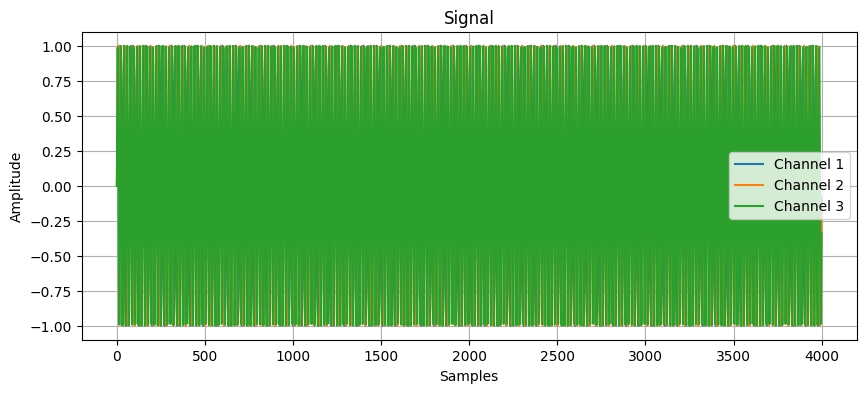

In [3]:
fig = vis.plot_signal(data, sr=sample_rate)

## Step 3: Add white noise

In [4]:
white_noise_sig = add_white_noise(data, 0.2)
white_noise_sig.shape

(4000, 3)

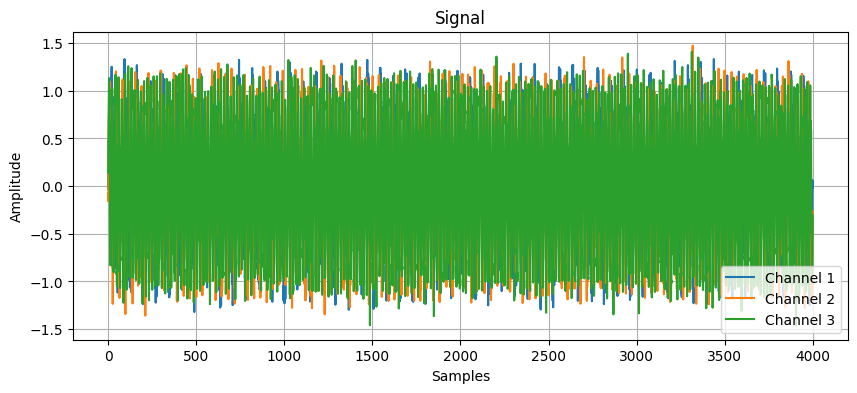

In [5]:
fig = vis.plot_signal(white_noise_sig, sr=sample_rate)

## Step 4: Random gain

In [6]:
random_gain_sig = random_gain(data)
random_gain_sig.shape

(4000, 3)

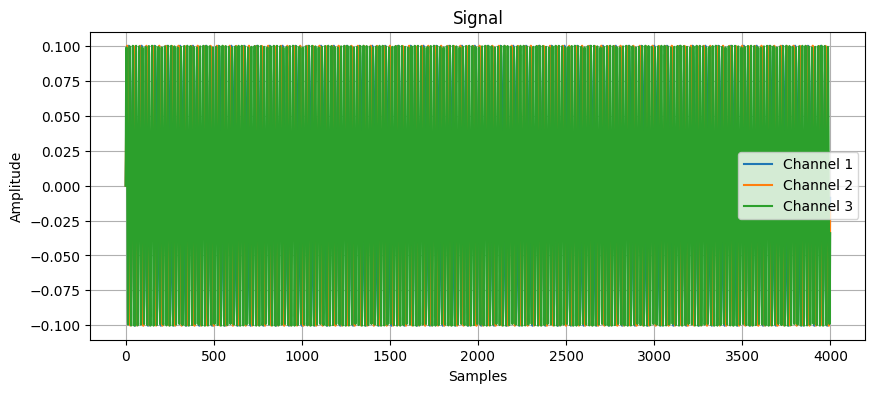

In [7]:
fig = vis.plot_signal(random_gain_sig, sr=sample_rate)

## Step 5: Inverse Polarity

In [8]:
polarity_sig = polarity_inversion(data)
polarity_sig.shape

(4000, 3)

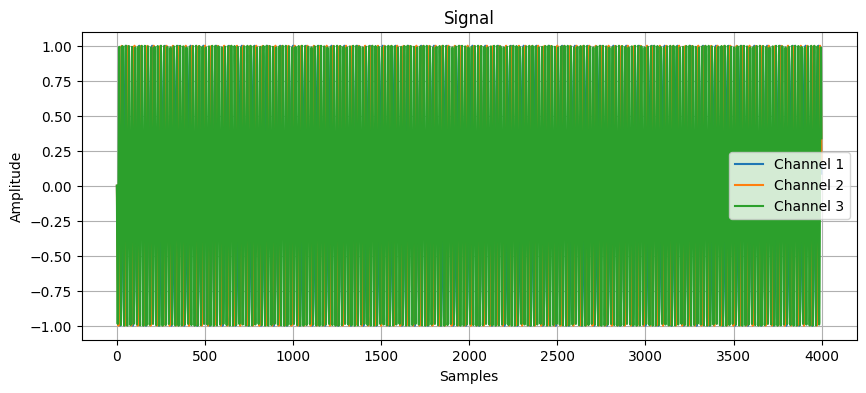

In [9]:
fig = vis.plot_signal(polarity_sig, sr=sample_rate)

## Step 6: Add noise

In [10]:
noise_ts_sig = add_noise_ts(data)
noise_ts_sig.shape

(4000, 3)

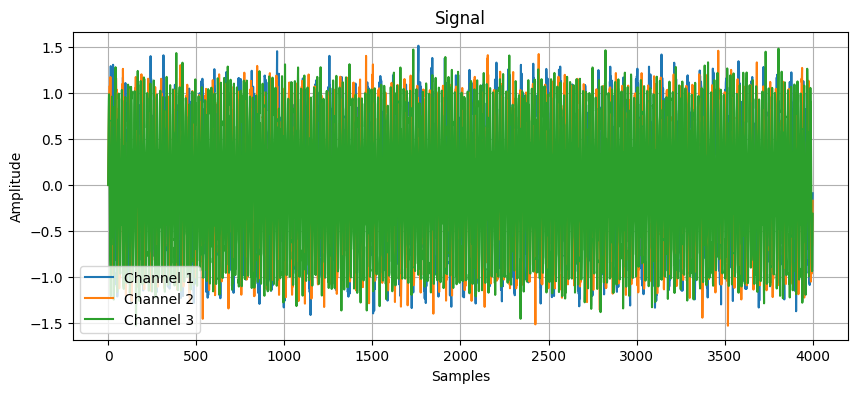

In [11]:
fig = vis.plot_signal(noise_ts_sig, sr=sample_rate)

## Step 7: Convolve

By default it passes the signal from a low-pass filter

In [12]:
convolve_ts_sig = convolve_ts(data)
convolve_ts_sig.shape

(4000, 3)

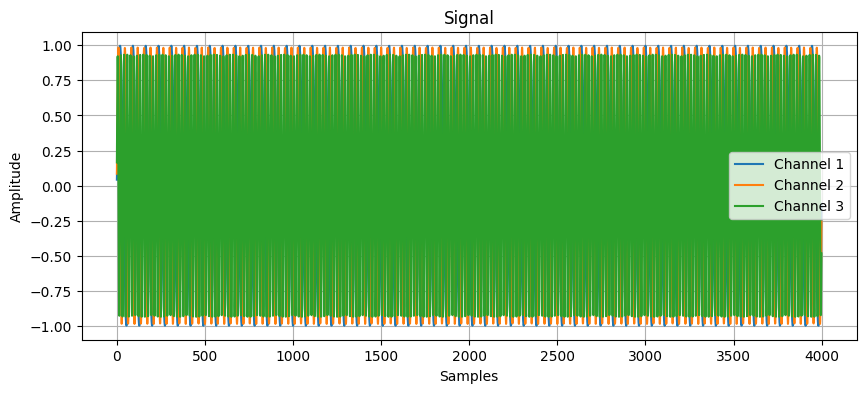

In [13]:
fig = vis.plot_signal(convolve_ts_sig, sr=sample_rate)

In [14]:
convolve_ts_sig = convolve_ts(data, per_channel=True)
convolve_ts_sig.shape

(4000, 3)

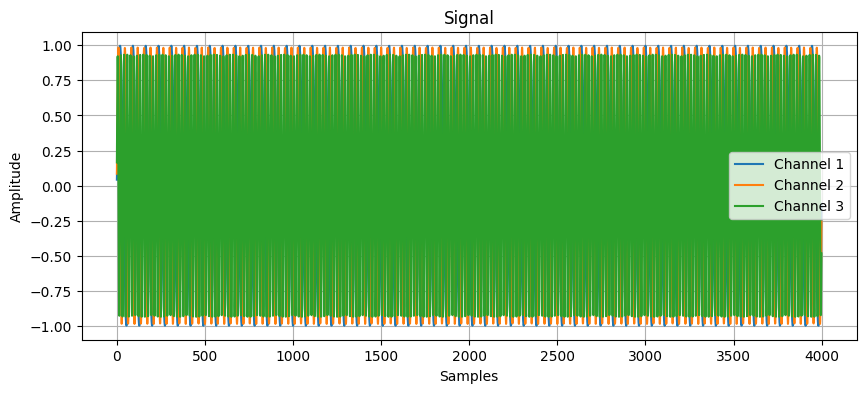

In [15]:
fig = vis.plot_signal(convolve_ts_sig, sr=sample_rate)

## Step 8: Array split in chunks

In [16]:
array_split_sig = arr_splitter(data, 32, 3)
array_split_sig.shape

(3, 32, 3)

## Step 9: Crop the signal

In [17]:
crop_ts_sig = crop_ts(data, 500)
crop_ts_sig.shape

(500, 3)

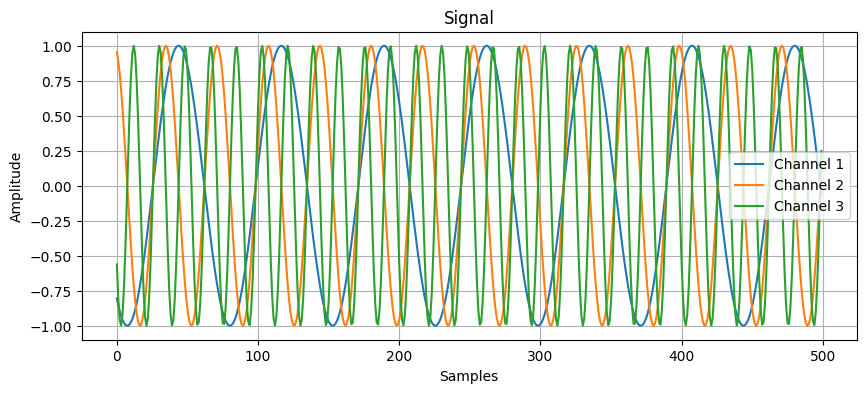

In [18]:
fig = vis.plot_signal(crop_ts_sig, sr=sample_rate)

## Step 10: Drift signal

In [19]:
drift_ts_sig = drift_ts(data)
drift_ts_sig.shape

(4000, 3)

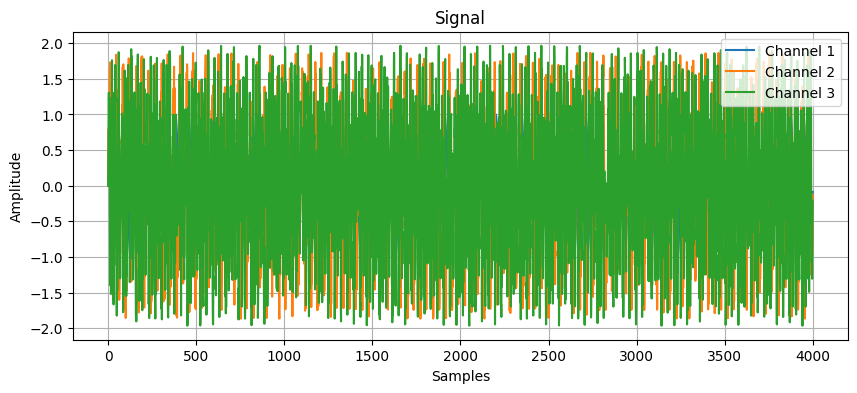

In [20]:
fig = vis.plot_signal(drift_ts_sig, sr=sample_rate)

## Step 11: Dropout

In [21]:
dropout_ts_sig = dropout_ts(data)
dropout_ts_sig.shape

(4000, 3)

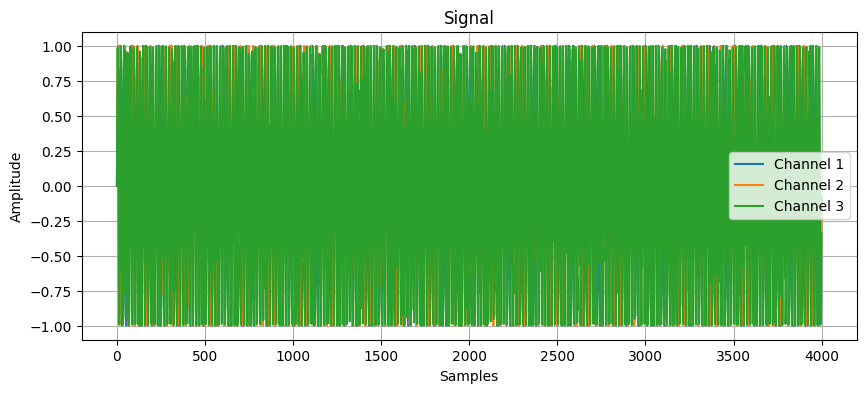

In [22]:
fig = vis.plot_signal(dropout_ts_sig, sr=sample_rate)

## Step 12: Pool signal

In [23]:
pool_ts_sig = pool_ts(data)
pool_ts_sig.shape

(4000, 3)

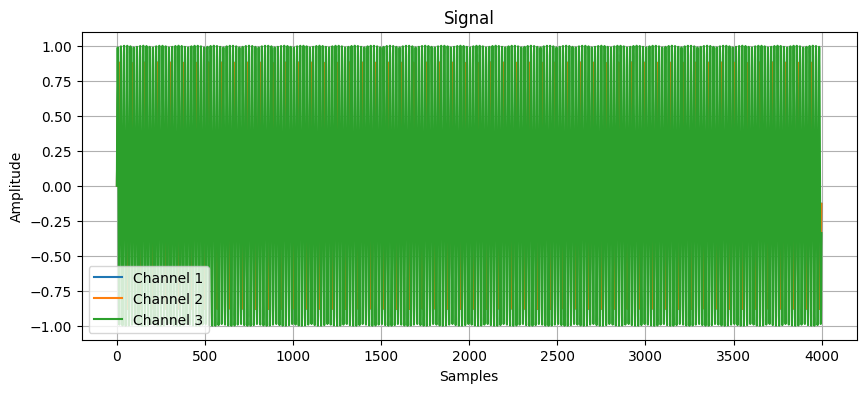

In [24]:
fig = vis.plot_signal(pool_ts_sig, sr=sample_rate)

## Step 13: Quantize signal

In [25]:
quantize_ts_sig = quantize_ts(data)
quantize_ts_sig.shape

(4000, 3)

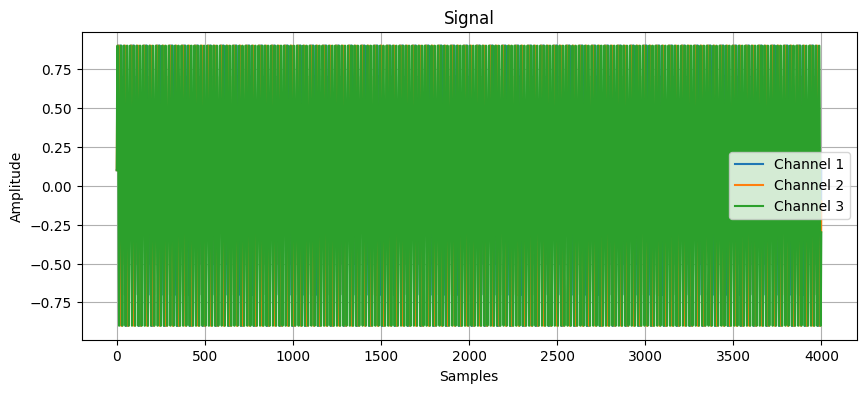

In [26]:
fig = vis.plot_signal(quantize_ts_sig, sr=sample_rate)

## Step 14: Resize signal

In [27]:
resize_ts_sig = resize_ts(data, size=800)
resize_ts_sig.shape

(800, 3)

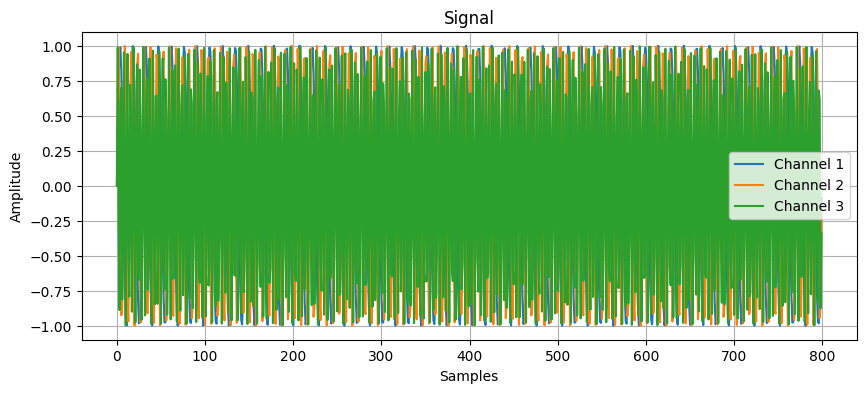

In [28]:
fig = vis.plot_signal(resize_ts_sig, sr=sample_rate)

## Step 15: Reverse signal

In [29]:
reverse_ts_sig = reverse_ts(crop_ts_sig)
reverse_ts_sig.shape

(500, 3)

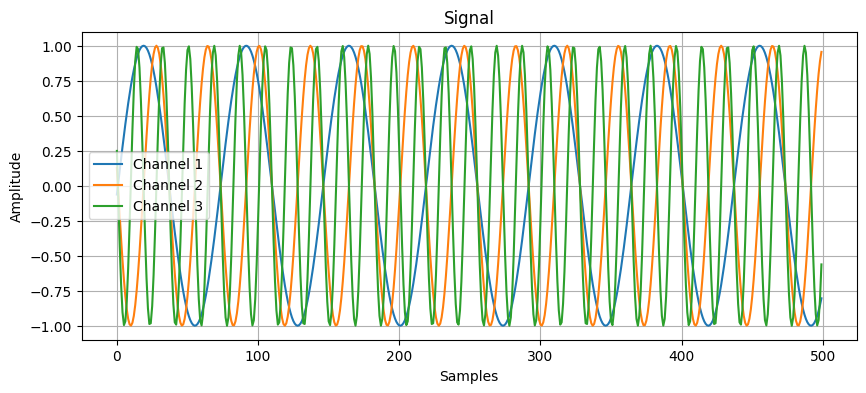

In [30]:
fig = vis.plot_signal(reverse_ts_sig, sr=sample_rate)

## Step 16: Time warp the signal

In [31]:
time_warp_ts_sig = time_warp_ts(data)
time_warp_ts_sig.shape

(4000, 3)

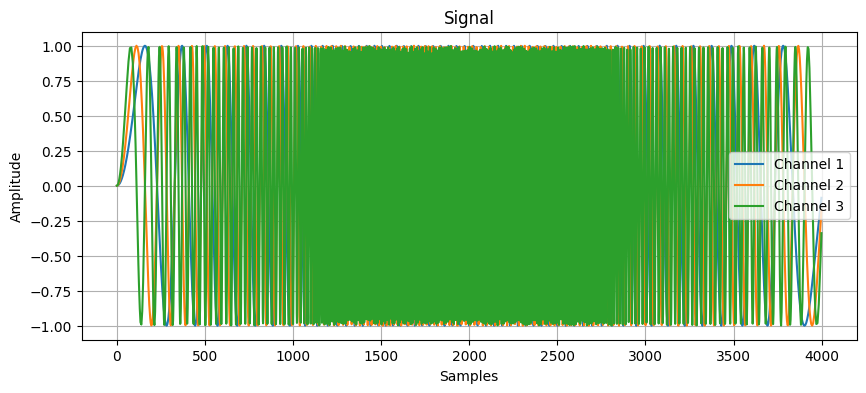

In [32]:
fig = vis.plot_signal(time_warp_ts_sig, sr=sample_rate)

## Step 17: Time stretch signal

In [33]:
time_stretch_ts_sig = time_stretch_ts(data, rate=2)
time_stretch_ts_sig.shape

(2000, 3)

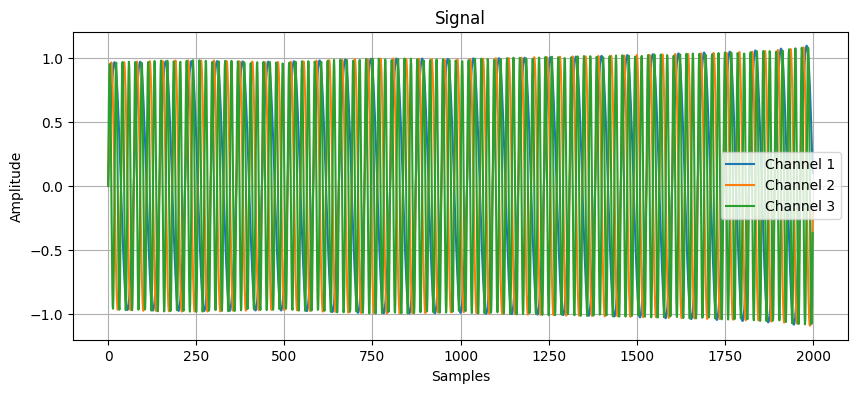

In [34]:
fig = vis.plot_signal(time_stretch_ts_sig, sr=sample_rate)

## Step 18: Pitch shift signal

In [35]:
pitch_shift_ts_sig = pitch_shift_ts(data, sr=16000, n_steps=7)
pitch_shift_ts_sig.shape

(4000, 3)

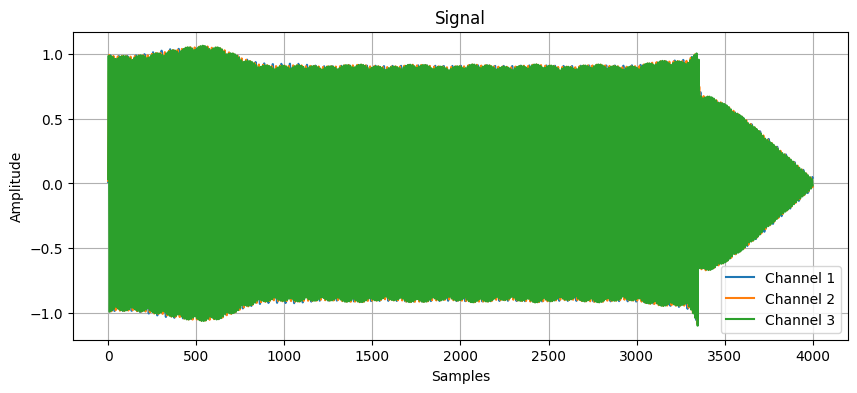

In [36]:
fig = vis.plot_signal(pitch_shift_ts_sig, sr=sample_rate)

In [37]:
from IPython.display import Audio

Audio(np.sum(data, axis=1), rate=sample_rate)

In [38]:
Audio(np.sum(pitch_shift_ts_sig, axis=1), rate=sample_rate)

In [39]:
sum_sig = data + pitch_shift_ts_sig
Audio(np.sum(sum_sig, axis=1), rate=sample_rate)

# Augmenting song

## Step 1: Import libraries and load data

In [40]:
from caits.loading import wav_loader, wav_specs_check

print(wav_specs_check("data/jmp-last-night.wav"))
jmp = wav_loader("data/jmp-last-night.wav")
print(f"shape: {jmp[0].shape} - Sampling rate: {jmp[1]}")
Audio(jmp[0].values.T, rate=jmp[1])


{'nchannels': 2, 'sampwidth': 2, 'framerate': 44100, 'nframes': 605391, 'comptype': 'NONE', 'compname': 'not compressed'}
shape: (605391, 2) - Sampling rate: 44100


## Step 2: Add white noise to song

In [41]:
jmp_white_noise = add_white_noise(jmp[0].values, noise_factor=0.2)
Audio(jmp_white_noise.T, rate=jmp[1])

## Step 3: Random gain on song

In [42]:
jmp_random_gain = random_gain(jmp[0].values)
Audio(jmp_random_gain.T, rate=jmp[1])

## Step 4: Polarity Inversion

In [43]:
jmp_polarity_inv = polarity_inversion(jmp[0].values)
Audio(jmp_polarity_inv.T, rate=jmp[1])

## Step 5: Add noise to song

In [44]:
jmp_add_noise = add_noise_ts(jmp[0].values)
Audio(jmp_add_noise.T, rate=jmp[1])

## Step 6: Convolve song

Pass the song through a low-pass filter.

In [45]:
jmp_conv = convolve_ts(jmp[0].values)
Audio(jmp_conv.T, rate=jmp[1])

## Step 7: Crop the song

In [46]:
jmp_crop = crop_ts(jmp[0].values, 300000)
Audio(jmp_crop.T, rate=jmp[1])

## Step 8: Drift the song

In [47]:
jmp_drift = drift_ts(jmp[0].values, max_drift=1.5)
Audio(jmp_drift.T, rate=jmp[1])

## Step 9: Dropout

In [48]:
# jmp_dropout = dropout_ts(jmp[0].values, size=20000)
# Audio(jmp_dropout.T, rate=jmp[1])

## Step 10: Perform pooling on the song

In [49]:
jmp_pooled = pool_ts(jmp[0].values, kind="max")
Audio(jmp_pooled.T, rate=jmp[1])

## Step 11: Quantize song

In [50]:
jmp_quantized = quantize_ts(jmp[0].values, n_levels=8)
Audio(jmp_quantized.T, rate=jmp[1])

## Step 12: Resize the song

In [51]:
jmp_resized = resize_ts(jmp[0].values, size=300000)
Audio(jmp_resized.T, rate=jmp[1])

## Step 13: Reverse the song

In [52]:
jmp_reversed = reverse_ts(jmp[0].values)
Audio(jmp_reversed.T, rate=jmp[1])

## Step 14: Time warp the song

In [53]:
jmp_time_warp = time_warp_ts(jmp[0].values)
Audio(jmp_time_warp.T, rate=jmp[1])

## Step 15: Time stretch the song

In [54]:
jmp_time_strecth = time_stretch_ts(jmp[0].values, rate=1.5)
Audio(jmp_time_strecth.T, rate=jmp[1])

## Step 16: Pitch shift the song

In [55]:
jmp_pitch_shift = pitch_shift_ts(jmp[0].values, sr=jmp[1], n_steps=-3)
Audio(jmp_pitch_shift.T, rate=jmp[1])